# Image Merging

The task for the previous week was to try out ways and see how two or more images can be merged.

We are now going to look through a solution on how to merge two or more images using basic image transformations and a little bit of gradent blending.


### Installing dependencies and importing required libraries

In [36]:
!pip install mmcv==2.2.0 -f https://download.openmmlab.com/mmcv/dist/cu121/torch2.4/index.html
!pip install shapley
import cv2
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
import mmcv
import numpy as np
import math
import sys
import os


Defaulting to user installation because normal site-packages is not writeable
Looking in links: https://download.openmmlab.com/mmcv/dist/cu121/torch2.4/index.html
Defaulting to user installation because normal site-packages is not writeable


## Loading the dataset 

Here we are just reading the metadata from the `.pkl` file and loading it into a variable `frames`. 

With the frames varaible we can now look at multiple images taken at different timestamps to generate a merged image of how the surrounding of the ego vehicle looks like. 

I've created several functions that can be reused to play around and generate panoramic views of different frames.

In [37]:
def load_frame_images(timestamp, image_folder="train", folder_number="00000"):
    data_dict_subset_A = pd.read_pickle('../repo/OpenLane-V2/data/OpenLane-V2/data_dict_subset_A.pkl')
    images = []
    root_path = "../repo/OpenLane-V2/data/OpenLane-V2/data_files/"
    frame1 = data_dict_subset_A[(image_folder, folder_number, timestamp)]
    for view in frame1['sensor'].keys():
        images.append(f"{root_path}{frame1['sensor'][view]['image_path']}")
        
    return images

images = load_frame_images(timestamp="315967392349927214")

The `load_frame_images` function here loads all the images that we have for one frame into a varible called `images`. 

Once loaded we can use the `images` variable for that frame to display, process and access pictures.

### Load Metadata

Now that we have laoded the image, we can also load the metadata for the frame so we can get the camera parameters that we need to work with.

In [44]:
import json
def get_metadata(timestamp, image_folder="train", folder_number="00000"):
    root_path = "../repo/OpenLane-V2/data/OpenLane-V2/data_files/"
    with open(f"{root_path}{image_folder}/{folder_number}/info/{timestamp}.json", "r") as file:
        data = json.load(file)

    return data

metadata = get_metadata(timestamp="315967392349927214")

### Displaying and Resizing images

Since all the images that we have, contain different aspect ratios and different sizes, 

we need to resize them in such a way so that we only contain the necessary information and have similar dimensions so we can stack the images wihtout any dimensionality issues.

(1868, 1550, 3)
(1550, 2048, 3)


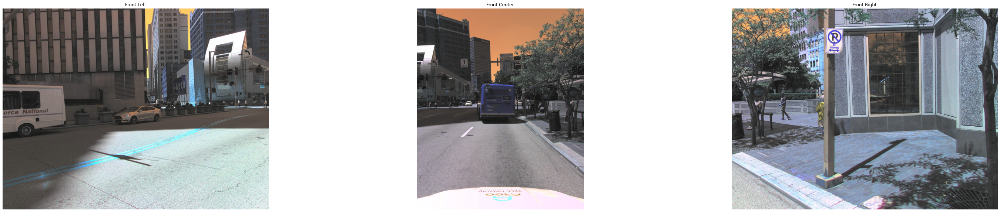

In [3]:
front_center = mmcv.imread(images[0])
front_left = mmcv.imread(images[1])
front_right = mmcv.imread(images[2])
side_left = mmcv.imread(images[5])
side_right = mmcv.imread(images[6])
rear_left = mmcv.imread(images[3])
rear_right = mmcv.imread(images[4])

fig, axes = plt.subplots(1, 3, figsize=(50, 10))

# Show the first image
axes[0].imshow(front_left)
axes[0].axis('off')  # Turn off axis
axes[0].set_title('Front Left')

height = front_center.shape[0]
# Crop to the bottom picture
bottom_half = front_center[180 :, :]
print(bottom_half.shape)
print(front_left.shape)


axes[1].imshow(bottom_half)
axes[1].axis('off')
axes[1].set_title('Front Center')

axes[2].imshow(front_right)
axes[2].axis('off')
axes[2].set_title('Front Right')
plt.show()

Text(0.5, 1.0, 'Rear Right')

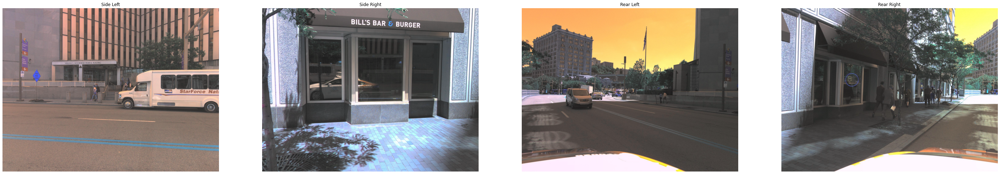

In [4]:
fig, axes = plt.subplots(1, 4, figsize=(50, 10))


axes[0].imshow(side_left)
axes[0].axis('off')
axes[0].set_title('Side Left')


axes[1].imshow(side_right)
axes[1].axis('off')
axes[1].set_title('Side Right')


axes[2].imshow(rear_left)
axes[2].axis('off')
axes[2].set_title('Rear Left')


axes[3].imshow(rear_right)
axes[3].axis('off')
axes[3].set_title('Rear Right')


## Placing the images

Now we will try and stack the images in a single array, thereby placing them side by side

We can now see how these images are aliging with each other. 

There are objects that can be detected twice by any good object detection model. 

So now we try and merge them in such a way so that any duplicacy is removed. 

(1868, 2048, 3)
(1868, 1550, 3)


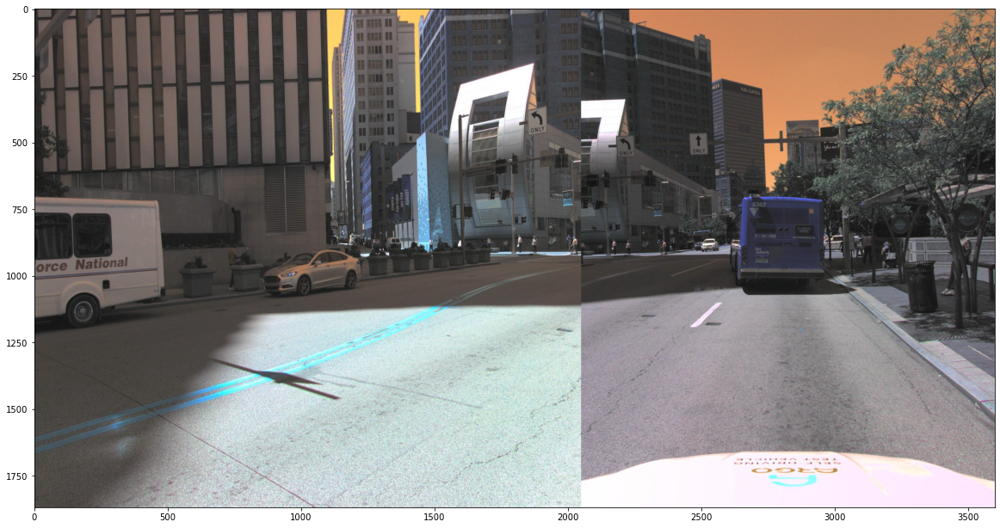

In [161]:
front_left = mmcv.imresize(front_left, (2048, 1868))
panoramic_image_test = np.hstack((front_left, bottom_half))

plt.figure(figsize=(20, 20))
plt.imshow(panoramic_image_test)

print(front_left.shape)
print(bottom_half.shape)
plt.show()

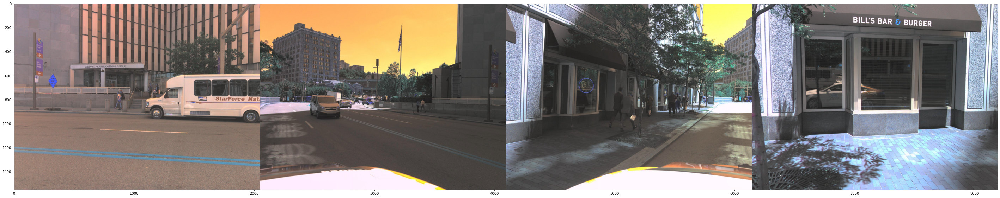

In [162]:
panoramic_image_2 = np.hstack((side_left, rear_left, rear_right, side_right))

plt.figure(figsize=(50, 20))
plt.imshow(panoramic_image_2)
plt.show()

### Blending the Images

We can now blend these images to make a more uniform image that can now be used to detect and segment objects.

In [165]:
def blend_and_show(img1, img2, overlap_width=350):
    image1_non_overlap = img1[:, :-overlap_width]
    image2_non_overlap = img2[:, overlap_width:]
    image1_overlap = img1[:, -overlap_width:]
    image2_overlap = img2[:, :overlap_width]

    weights = np.linspace(0, 1, overlap_width).reshape(1, -1, 1)

    blended_overlap = (1 - weights) * image1_overlap + weights * image2_overlap
    blended_overlap = blended_overlap.astype(np.uint8)

    panoramic_image = np.hstack((image1_non_overlap, blended_overlap, image2_non_overlap))

    plt.figure(figsize=(30, 30))
    plt.imshow(panoramic_image)
    plt.show()
    return panoramic_image


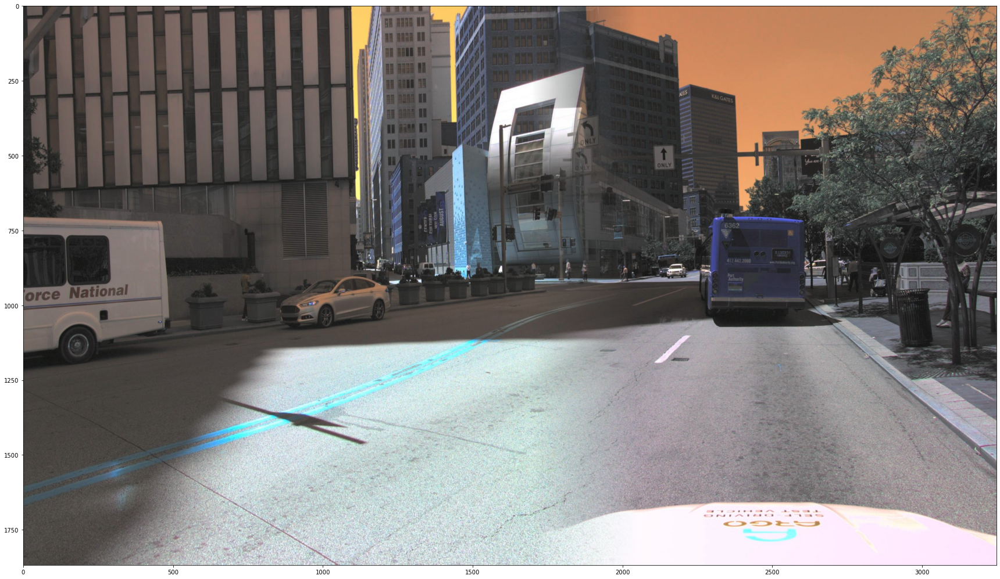

In [166]:
fl_fc = blend_and_show(front_left, bottom_half)

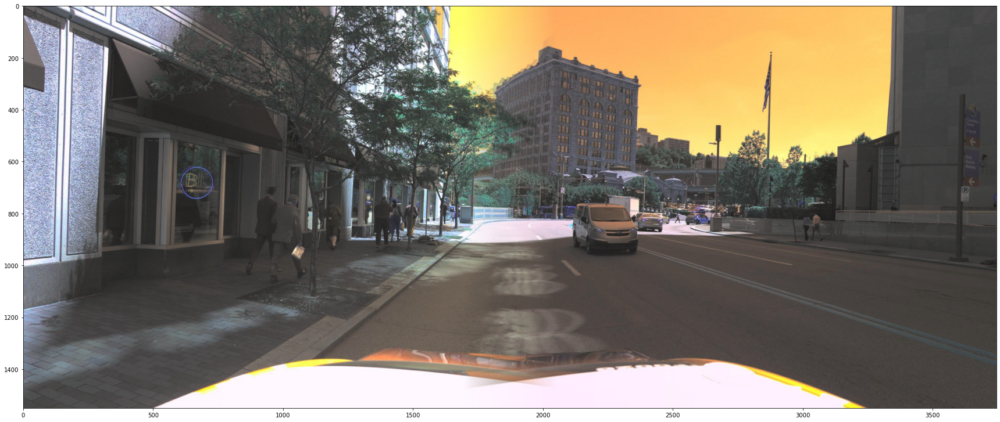

In [167]:
rr_rl = blend_and_show(rear_right, rear_left)

### Blending Side right and Rear

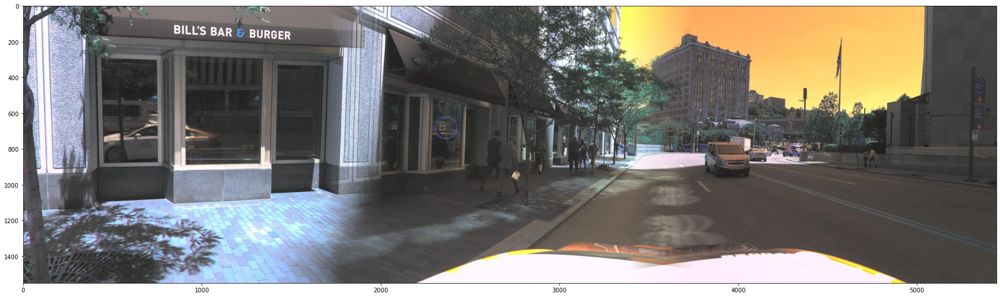

In [168]:
sr_rr_rl = blend_and_show(side_right, rr_rl)

### Blending the rear and rear-right

rl_rr = blend_and_show()


### Blending in Side Right


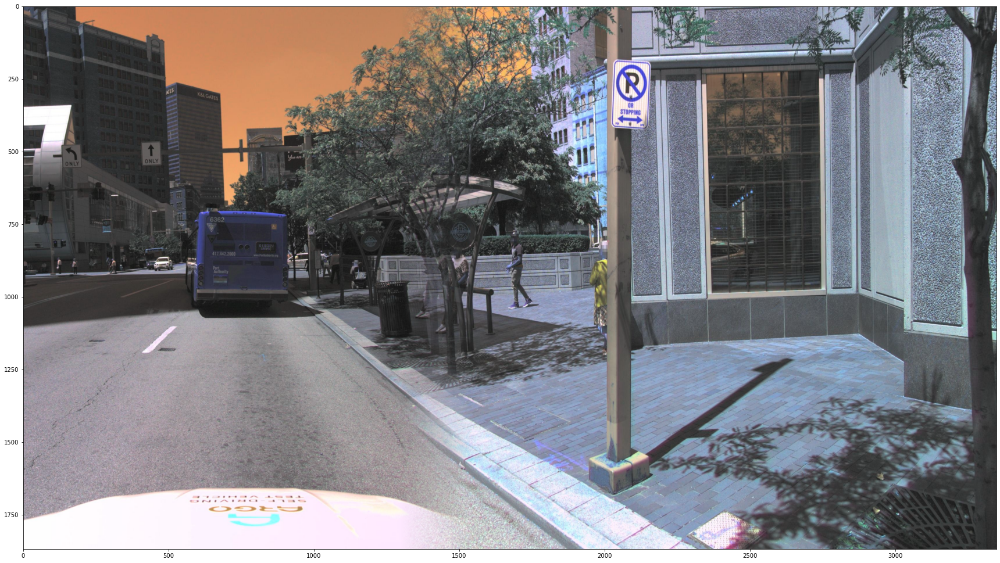

In [169]:
fc_fr = blend_and_show(bottom_half, front_right, 250)

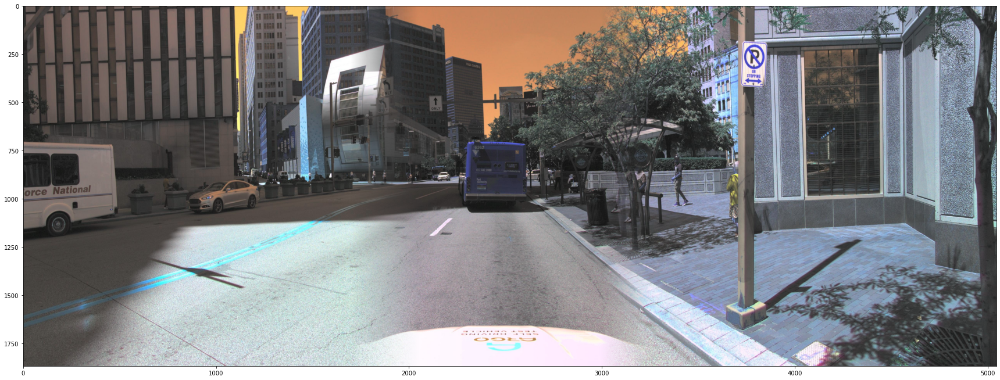

In [170]:
fl_fc_fr = blend_and_show(front_left, fc_fr)

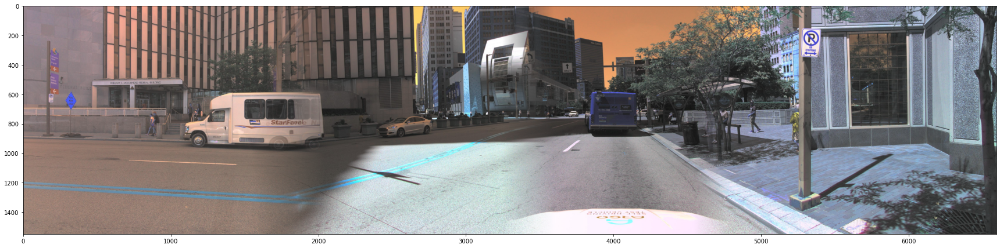

In [184]:
sl_fl_fc_fr = blend_and_show(side_left, mmcv.imresize(fl_fc_fr, (5046, 1550)), 500)


# All in one? 

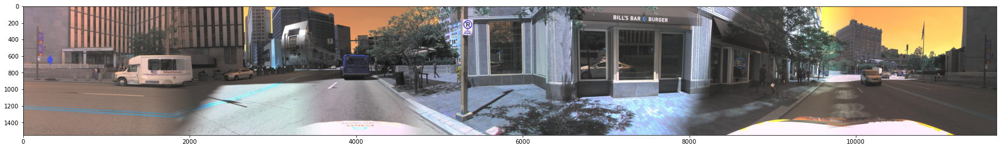

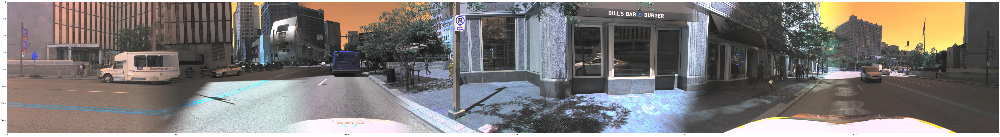

In [189]:
all_in_one = blend_and_show(sl_fl_fc_fr, sr_rr_rl)

plt.figure(figsize=(100, 50))
plt.imshow(all_in_one)
plt.show()


In [8]:
mmcv.imwrite(panoramic_image, "../merged_image3.jpg")

True

# TODO: CNN for Object Detection

This week we are going to focus on creating a CNN such that we can detect objects that are present in the merge Images. 

We will be using these to create a Sequential Model that can then be used to detect objects better / to detect them for our use cases where objects are not clearly outlined.

Few ideas to get you started
- YOLOv8
- Self Made CNN to better fit usecases
- RtDETR(Optional)




# TODO: Transforming Image to remove artifacts


Using intrinsic and extrinsisc properties of cameras, now we can stitch these images. 

In [16]:
path = os.listdir("../repo/OpenLane-V2/data/OpenLane-V2/data_files/train/")
frames=[]
for dir in path: 
    # print(dir, os.listdir("../repo/OpenLane-V2/data/OpenLane-V2/data_files/train/" + dir + "/image/"))
    if dir != ".DS_Store":
        camera_angels = os.listdir("../repo/OpenLane-V2/data/OpenLane-V2/data_files/train/" + dir + "/image/")
        # num_of_files = len(os.listdir("../repo/OpenLane-V2/data/OpenLane-V2/data_files/train/" + dir + "/image/ring_front_center"))
        for angle in camera_angels:
            num_of_files = len(os.listdir("../repo/OpenLane-V2/data/OpenLane-V2/data_files/train/" + dir + "/image/" + angle))
            for i in range(0, num_of_files):
                frame = []
                if angle != ".DS_Store":
                    photos = os.listdir("../repo/OpenLane-V2/data/OpenLane-V2/data_files/train/" + dir + "/image/" + angle)
                    frame.append("../repo/OpenLane-V2/data/OpenLane-V2/data_files/train/" + dir + "/image/" + angle + "/" + photos[i])
                frames.append(frame)


In [191]:
camera_angels = os.listdir("../repo/OpenLane-V2/data/OpenLane-V2/data_files/train/00000/image/")
print(json.dumps(metadata["sensor"][f"{camera_angels[0]}"]["intrinsic"], indent = 4))

{
    "K": [
        [
            1777.3341064453125,
            0.0,
            778.22265625
        ],
        [
            0.0,
            1777.3341064453125,
            1016.2135009765625
        ],
        [
            0.0,
            0.0,
            1.0
        ]
    ],
    "distortion": [
        -0.24358925276728224,
        -0.20579766495000962,
        0.3220590772907029
    ]
}


In [192]:
print(json.dumps(metadata["sensor"][f"{camera_angels[0]}"]["extrinsic"], indent = 4))

{
    "rotation": [
        [
            -0.000957540533607637,
            0.005281593251815597,
            0.9999855938406558
        ],
        [
            -0.9999990760125734,
            -0.0009699744380582409,
            -0.0009524303592692851
        ],
        [
            0.0009649301146935629,
            -0.9999855818572146,
            0.005282517161530775
        ]
    ],
    "translation": [
        1.6368501587787747,
        0.002139529966941308,
        1.4059079864120536
    ]
}


To apply these transformations to each image and then blend those images together, we will use a formula and a function defined in the cv2 library. 

- Formula:
   - Projection Matrix : $$P = K[R∣t]$$
   
- Cv2
    - The Cv2 library has a lot of useful functions and the function `wrap prespective` will be useful in this scenario so that we can project the intrinsic and extrinsic params of the image
